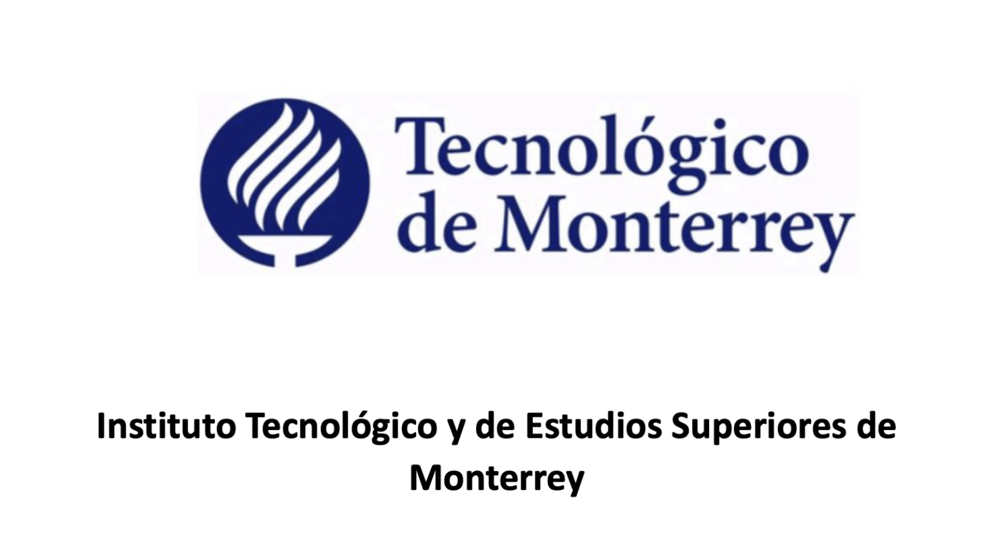

Santi

# **WATERSHED**

## **TEAM 12**

| Name                             | Enrollment Number | Role                               | Responsibilities |
|----------------------------------|------------------|-----------------------------------|------------------|
| **César Manuel Tirado Peraza**   | A01795845        | Principal Researcher              | Defines issues and audits the project related to watershed. |
| **Alberto Campos Hernández**     | A01795645        | Technical Documenter              | Writes the structure of contributions from all team members in an organized manner. |
| **Luis Alejandro Juárez Rodríguez** | A01795463      | Evaluation Specialist             | Audits the project development and defines the frameworks to be used. |
| **Isaac Manríquez Calderón**      | A01206674        | Data Scientist                    | Manages the project process and development. |
| **Santiago Reyes Chávez**         | A01027358        | Computer Vision Engineer          | Develops the image processing algorithm. |


# **Introducción**: 

**Segmentación de Imagenes:** 



In [1]:
# Librerías
import cv2
import matplotlib.pyplot as plt
import numpy as np
from scipy import ndimage as ndi
from skimage import data, morphology
from skimage.color import label2rgb
from skimage.filters import sobel
from skimage.segmentation import watershed

# **Fórmulas:**

In [2]:
# GLOBAL FUNCTIONS:

def leer_img(image_path, gray=False):
    """Función de leer paths y retornar imagenes, se puede definir si es a escala de grises o no."""
    img = cv2.imread(image_path)  
    if gray == False:
        img_output = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    else:
        img_output = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img_output

def viz_1_img(img_1, t_1):
    """Función para visualizar una imagen, debe de usarse despues de 
    leer_img(path)"""
    fig = plt.figure(figsize=(20,5))
    # img_1 
    a=fig.add_subplot(1,1,1)
    imgplot = plt.imshow(img_1, "gray")
    a.set_title(t_1)
    plt.axis('off')

def viz_2_img(img_1, img_2, t_1, t_2, tipo='Normal'):
    """Función para visualizar 2 imagenes en dos columnas, debe de usarse despues de 
    leer_img(path), la segunda imagen, se puede especificar con tipo, el tipo de imagen 
    que se le pasara dependiendo el proceso de watershed."""
    fig = plt.figure(figsize=(16.5,5))
    # img_1 
    a=fig.add_subplot(1,2,1)
    imgplot = plt.imshow(img_1, "gray")
    a.set_title(t_1)
    plt.axis('off')
    
    # Especificando el tipo de imagen a pasar del procesamiento. 
    if tipo == 'Normal':
        b=fig.add_subplot(1,2,2)
        imgplot = plt.imshow(img_2, "gray")
        b.set_title(t_2)
        plt.axis('off')
    elif tipo == 'Barra':
        b=fig.add_subplot(1,2,2)
        b.set_title(t_2)
        imgplot = plt.imshow(img_2, cmap=plt.cm.YlGnBu.reversed(), interpolation='nearest')
        plt.colorbar(imgplot,ax=b,  fraction=0.012, pad=0.04)
        plt.axis('off')
    elif tipo == 'Hist':
        b=fig.add_subplot(1,2,2)
        b.set_title(t_2)
        plt.hist(img_1.ravel(), bins=256, color='black', alpha=1)
        plt.ylabel("Frecuencia Pixeles")
    elif tipo == 'elevation_map':
        b=fig.add_subplot(1,2,2)
        b.set_title(t_2)
        plt.imshow(img_2, cmap=plt.cm.gray, interpolation='nearest')
        plt.axis('off')
    elif tipo == 'segmentation':
        b=fig.add_subplot(1,2,2)
        b.set_title(t_2)
        plt.imshow(img_2, cmap=plt.cm.gray, interpolation='nearest')
        plt.axis('off')
    elif tipo == 'watershed_segmentation':
        b=fig.add_subplot(1,2,2)
        b.set_title(t_2)
        plt.imshow(img_1, cmap=plt.cm.gray, interpolation='nearest')
        plt.contour(img_2, [0.5], linewidths=1.2, colors='y')
        plt.axis('off')
    elif tipo == 'watershed_color':
        b=fig.add_subplot(1,2,2)
        b.set_title(t_2)
        plt.imshow(img_2, interpolation='nearest')
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

def titulo_global(titulo):
    """Funcion para crear un título global, solo se le pasa un texto"""
    plt.figure(figsize=(20, 1))
    plt.text(0.5, 0.5, titulo, ha='center', va='center', fontsize=20)
    plt.axis('off')
    plt.show()  

def nota_small(titulo):
    """Similar a la funcion titulo_global, solo que de menor importancia,
    similar a # y ## en markdown"""
    plt.figure(figsize=(20, 1))
    plt.text(0.5, 0.5, titulo, ha='center', va='center', fontsize=10)
    plt.axis('off')
    plt.show()  

# PROYECT FUNCTIONS:
# formulas de codigo de scikit learn    

def barra_color_graymap(imagen):
    """Funcion para pasar el mapa a partir de los markers
    es para ver los pixeles máximos en el grayscale."""
    markers = np.zeros_like(imagen)
    markers[imagen < 30] = 1
    markers[imagen > 150] = 2
    return markers  

def watershed_selection(imagen, process=None):
    """Funcion que segmenta los procesos de watershed y documentar el proceso visualmente para 
    el proyecto."""
    try:
        if process == 'elevation_map':
            elevation_map = sobel(imagen)
            return elevation_map
        elif process == 'segmentation':
            elevation_map = sobel(imagen)
            markers = np.zeros_like(imagen)
            markers[imagen < 30] = 1
            markers[imagen > 150] = 2
            segmentation = watershed(elevation_map, markers)
            return segmentation
        elif process == 'watershed_1':
            segmentation, image_label_overlay = full_watershed(imagen)
            return segmentation
        elif process == 'watershed_2':
            segmentation, image_label_overlay = full_watershed(imagen)
            return image_label_overlay

    except:
        ValueError('Se tiene que poner un valor en process, elevation_map, segmentation')

def full_watershed(imagen):
    """
    Es el proceso completo, se usa para la segmentacion de watershed, sin embargo, retorno dos
    para la parte de ilumincación.
    """
    elevation_map = sobel(imagen)
    markers = np.zeros_like(imagen)
    markers[imagen < 30] = 1
    markers[imagen > 150] = 2
    segmentation = watershed(elevation_map, markers)
    
    segmentation = ndi.binary_fill_holes(segmentation - 1)
    labeled_stuff, _ = ndi.label(segmentation)
    image_label_overlay = label2rgb(labeled_stuff, image=imagen)
    return segmentation, image_label_overlay

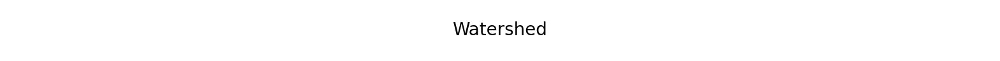

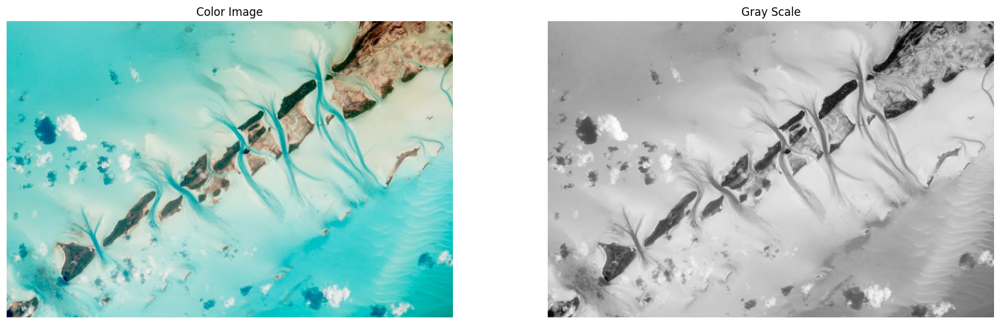

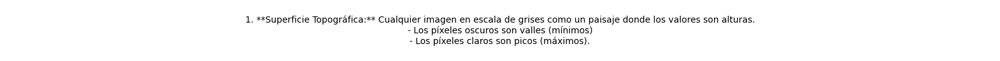

In [3]:
aereal = 'data/aereal.jpg'
img_1 = leer_img(aereal, gray=False)
img_1_gray = leer_img(aereal, gray=True)
titulo_global('Watershed')
viz_2_img(img_1, img_1_gray, 'Color Image', 'Gray Scale', tipo='Normal')
nota_small("""1. **Superficie Topográfica:** Cualquier imagen en escala de grises como un paisaje donde los valores son alturas.
- Los píxeles oscuros son valles (mínimos)
- Los píxeles claros son picos (máximos).""")

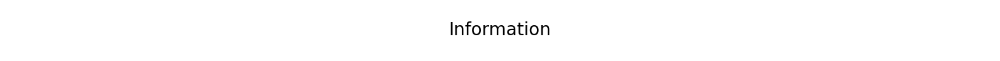

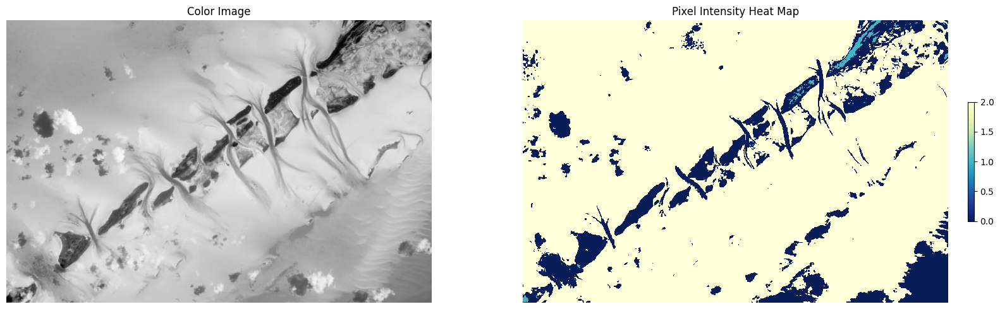

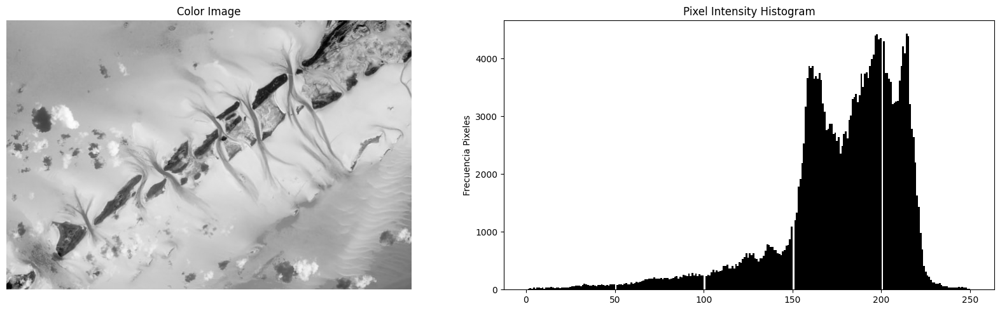

In [4]:
titulo_global('Information')
viz_2_img(img_1_gray, barra_color_graymap(img_1_gray), 'Color Image', 'Pixel Intensity Heat Map', tipo='Barra')
viz_2_img(img_1_gray, barra_color_graymap(img_1_gray), 'Color Image', 'Pixel Intensity Histogram', tipo='Hist')


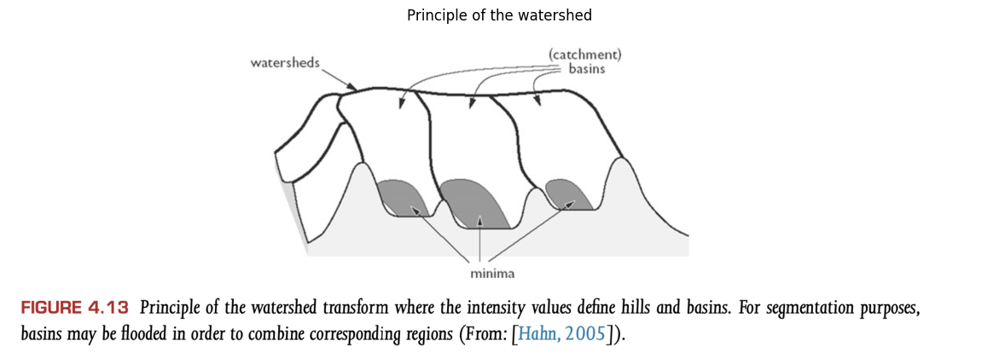

In [5]:
viz_1_img(leer_img('data/Docu_1.png', gray=False), 'Principle of the watershed')

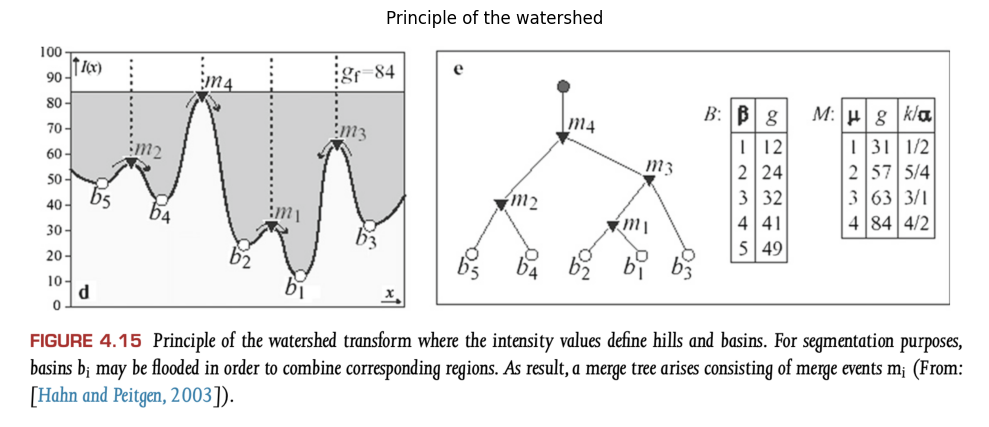

In [6]:
viz_1_img(leer_img('data/Docu_2.png', gray=False), 'Principle of the watershed')

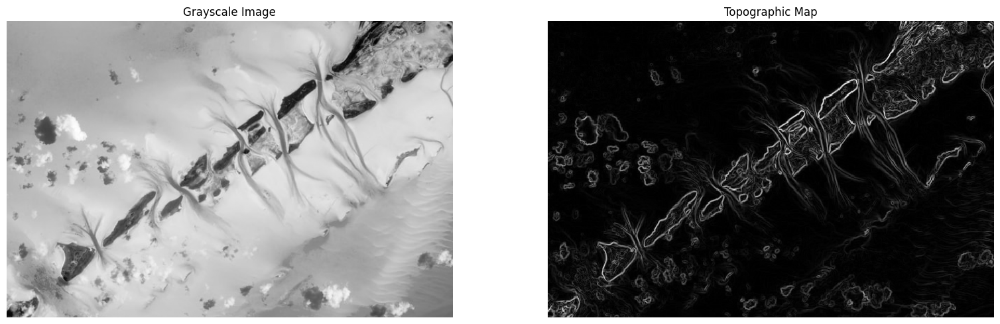

In [7]:
viz_2_img(img_1_gray, watershed_selection(img_1_gray, process='elevation_map'), 'Grayscale Image', 'Topographic Map', tipo='elevation_map')


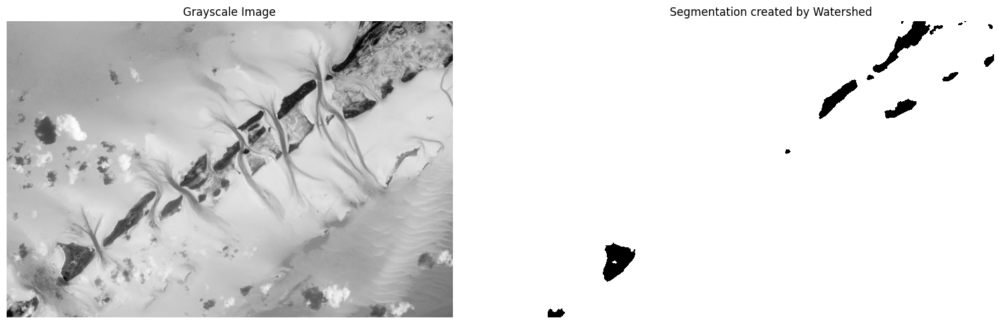

In [8]:
viz_2_img(img_1_gray, watershed_selection(img_1_gray, process='segmentation'), 'Grayscale Image', 'Segmentation created by Watershed', tipo='segmentation')

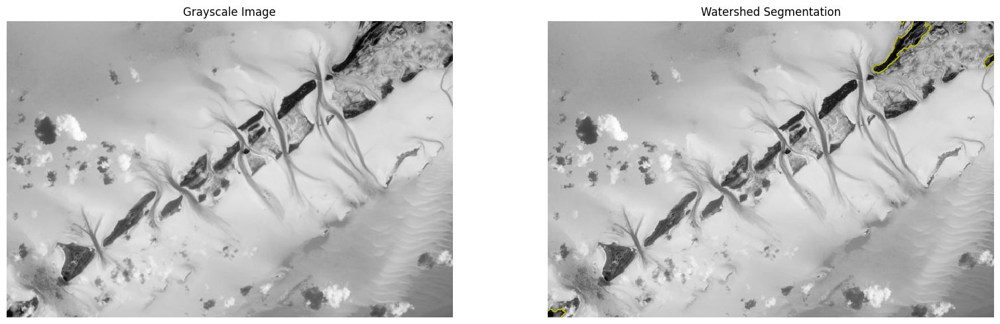

In [9]:
viz_2_img(img_1_gray, watershed_selection(img_1_gray, process='watershed_1'), 'Grayscale Image', 'Watershed Segmentation', tipo='watershed_segmentation')


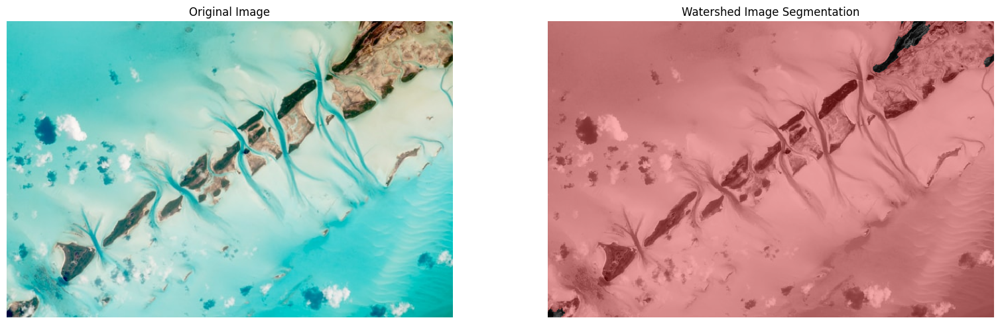

In [10]:
viz_2_img(img_1, watershed_selection(img_1_gray, process='watershed_2'), 'Original Image', 'Watershed Image Segmentation', tipo='watershed_color')


# **Pipeline**

In [11]:
def watershed_pipeline(image_path):
    """Create a pipeline to run everything in one line"""
    # Image stats
    aereal = image_path
    img_1 = leer_img(aereal, gray=False)
    img_1_gray = leer_img(aereal, gray=True)
    titulo_global('Understanding Watershed')
    viz_2_img(img_1, img_1_gray, 'Color Image', 'Grayscale Image', tipo='Normal')
    titulo_global('Image Information')
    viz_2_img(img_1_gray, barra_color_graymap(img_1_gray), 'Color Image', 'Pixel Intensity Heat Map', tipo='Barra')
    viz_2_img(img_1_gray, barra_color_graymap(img_1_gray), 'Color Image', 'Pixel Intensity Histogram', tipo='Hist')
    # What watershed does
    viz_2_img(img_1_gray, watershed_selection(img_1_gray, process='elevation_map'), 'Grayscale Image', 'Topographic Map', tipo='elevation_map')
    viz_2_img(img_1_gray, watershed_selection(img_1_gray, process='segmentation'), 'Grayscale Image', 'Segmentation created by Watershed', tipo='segmentation')
    viz_2_img(img_1_gray, watershed_selection(img_1_gray, process='watershed_1'), 'Grayscale Image', 'Watershed Segmentation', tipo='watershed_segmentation')
    viz_2_img(img_1, watershed_selection(img_1_gray, process='watershed_2'), 'Original Image', 'Watershed Image Segmentation', tipo='watershed_color')


# **IMAGENES**

In [12]:
# watershed_pipeline('data/monedas.jpg')

In [13]:
# Interesante porque detecto la luz, no las monedas como tal

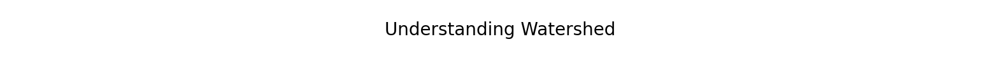

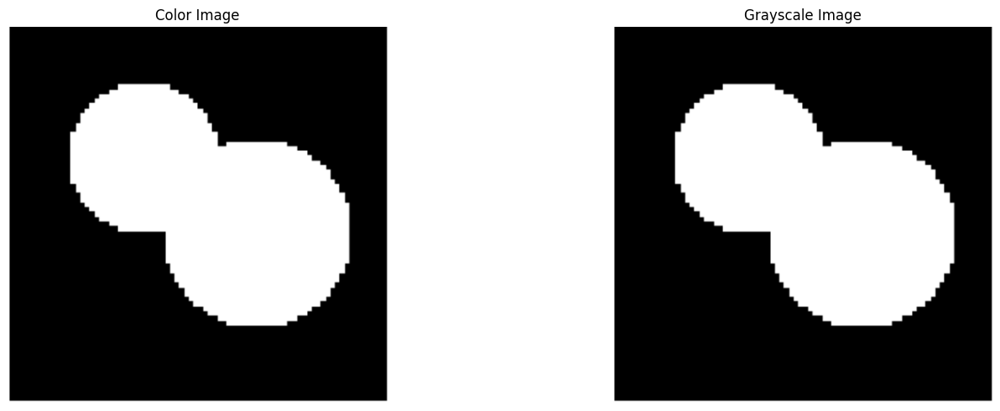

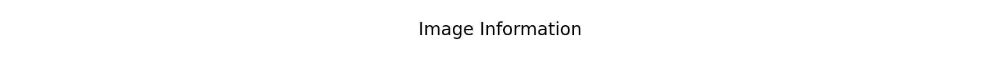

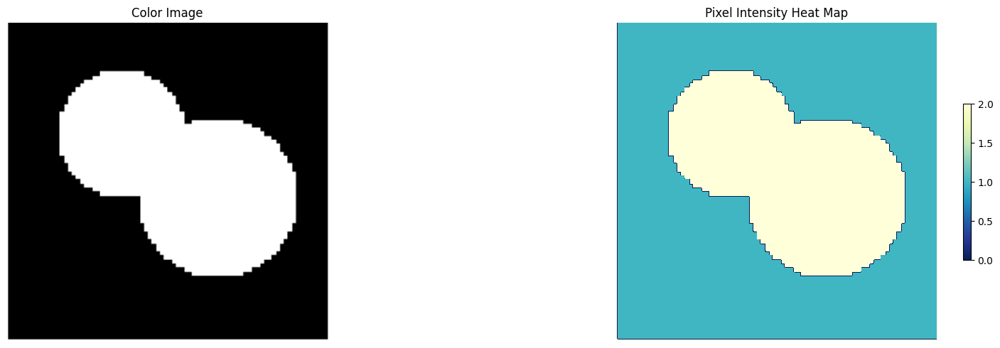

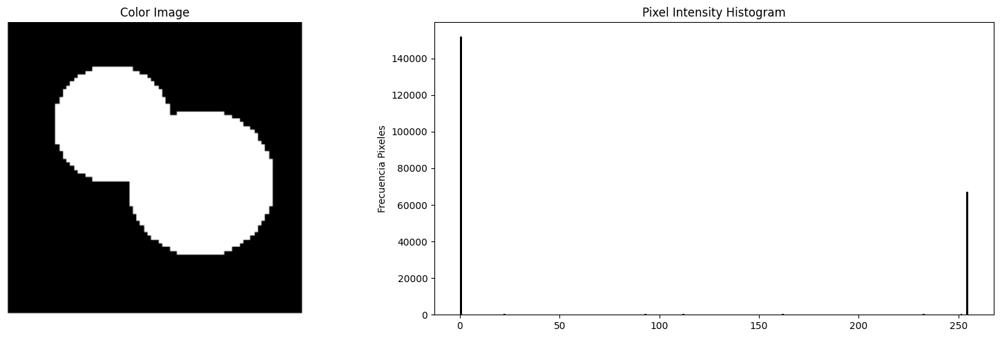

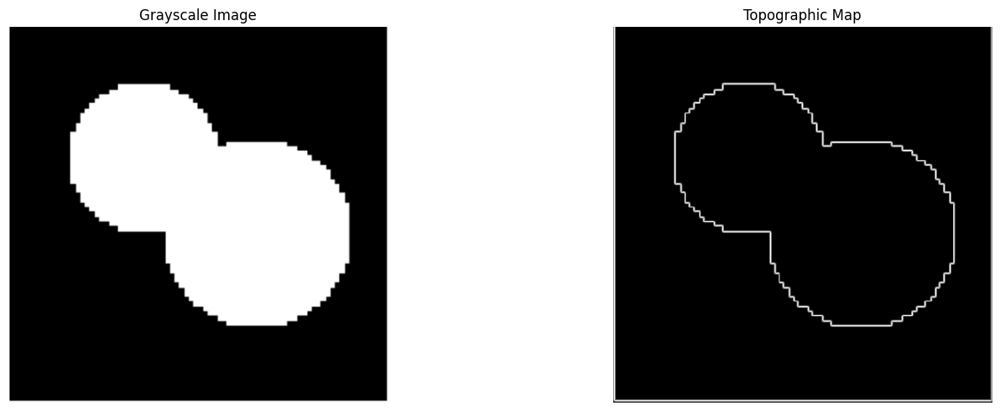

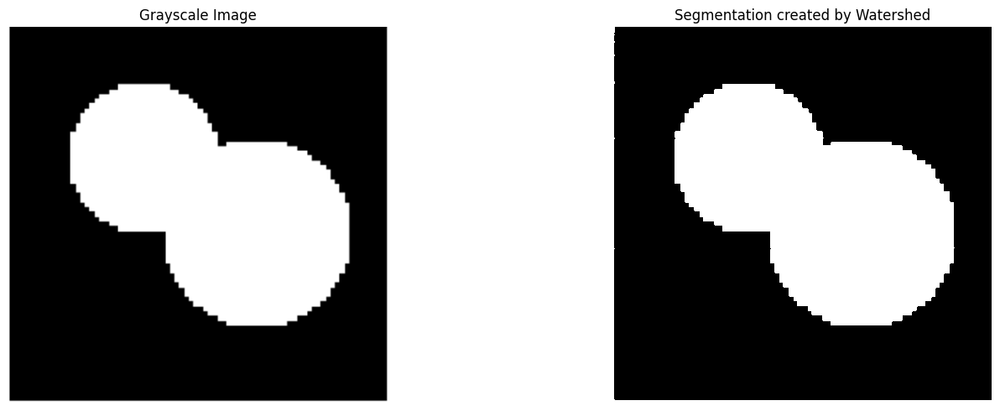

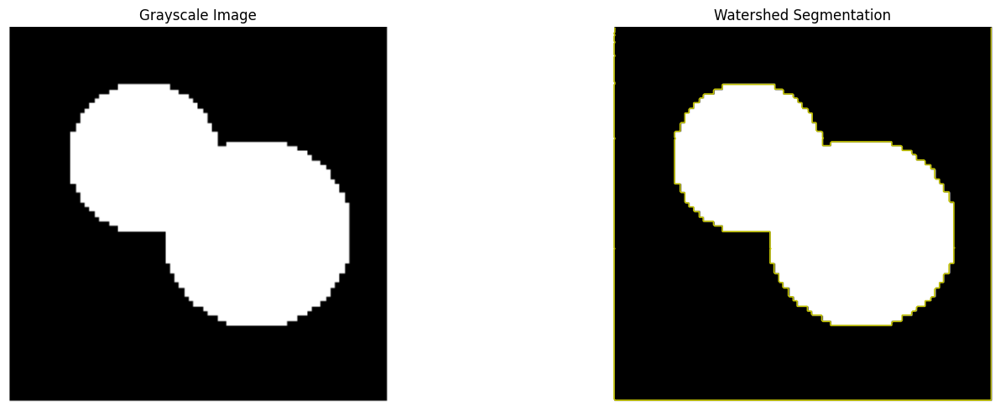

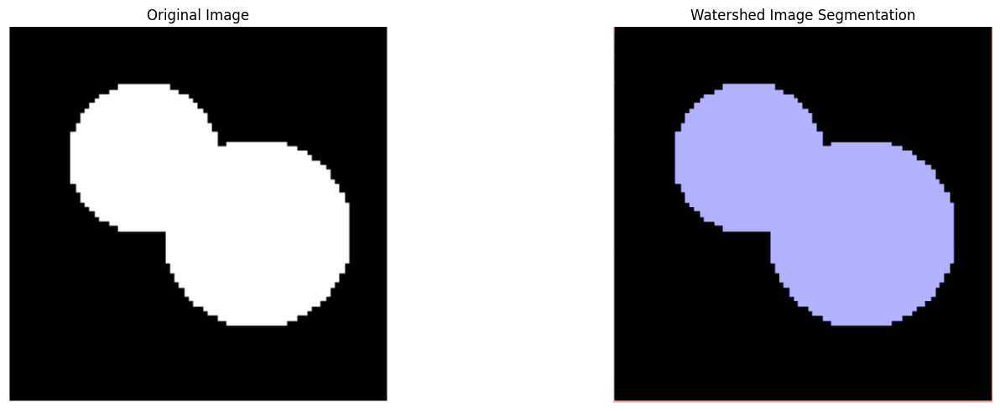

In [14]:
watershed_pipeline('data/test_2.png')

In [15]:
# se tiene que tratar la imagen

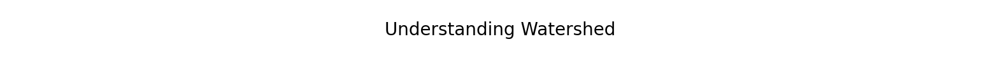

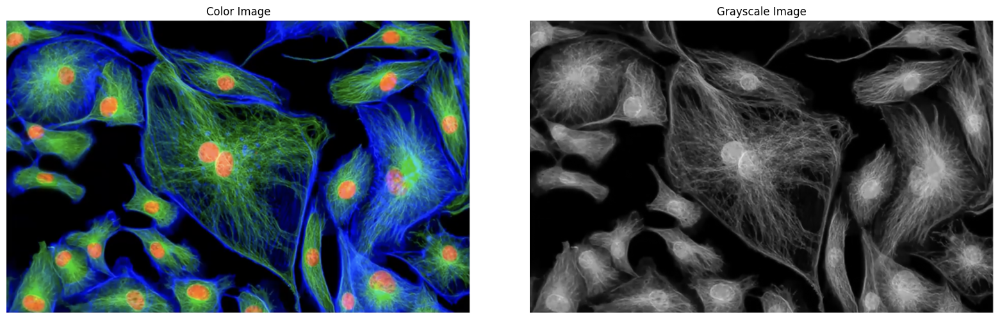

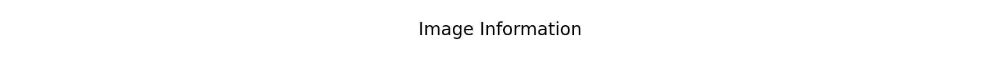

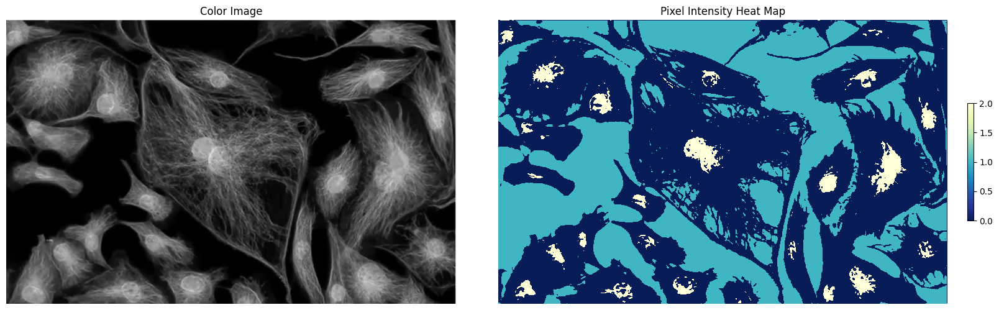

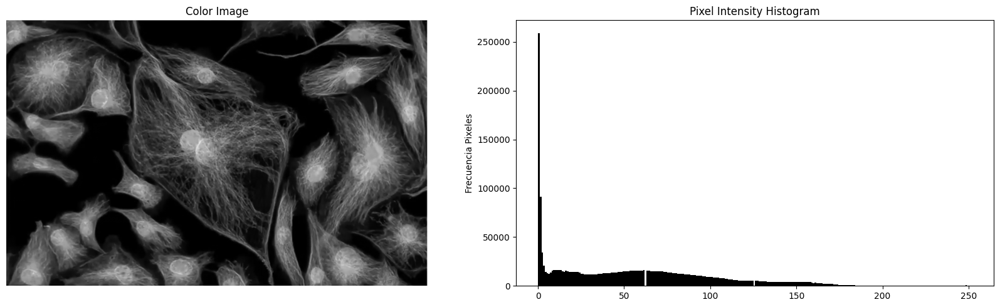

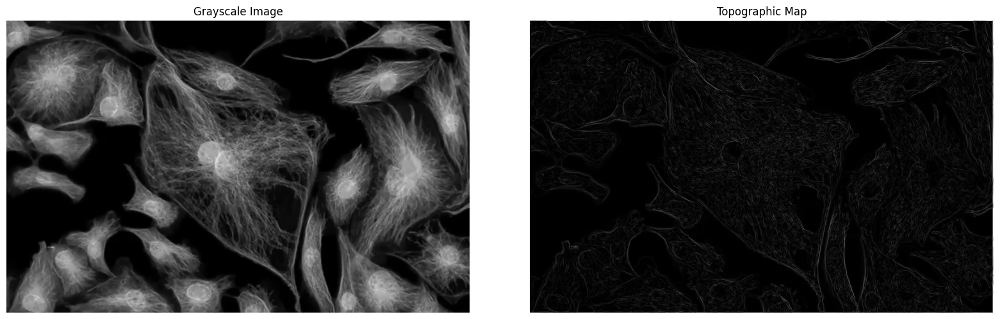

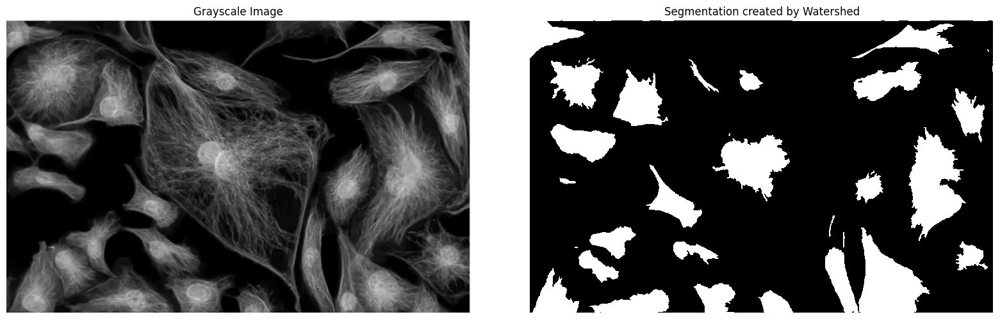

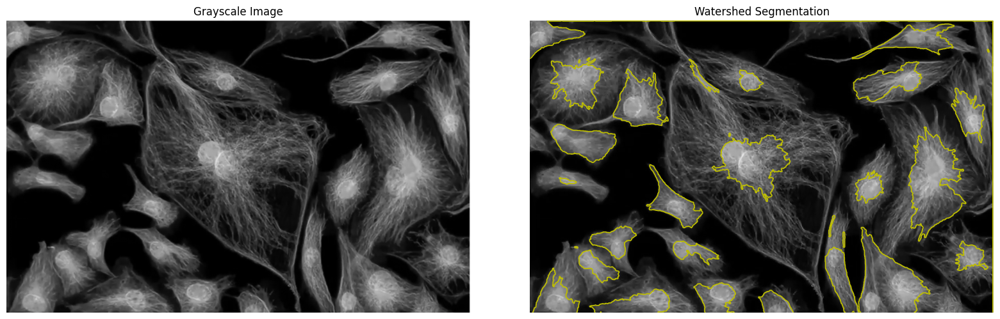

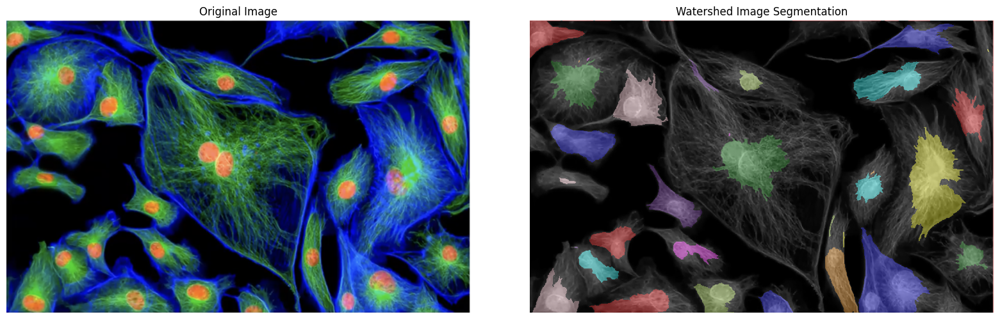

In [16]:
watershed_pipeline('data/team_pasado.png')

In [17]:
# funciona con contrastes brillantes

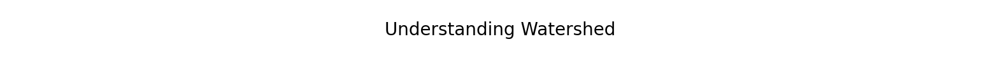

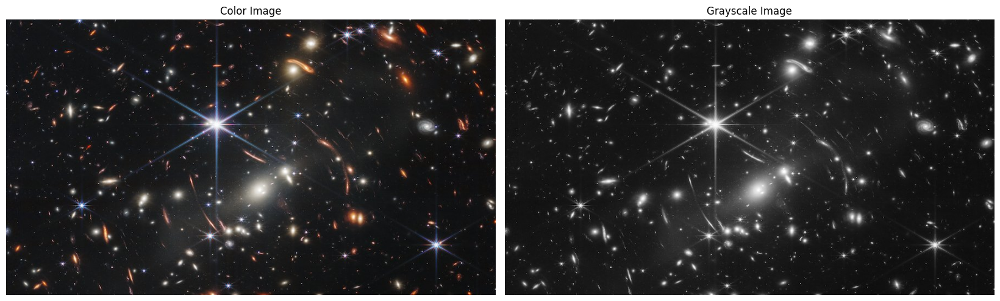

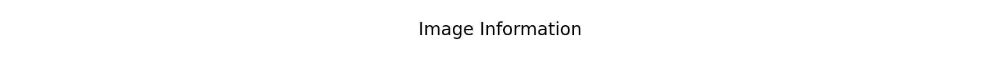

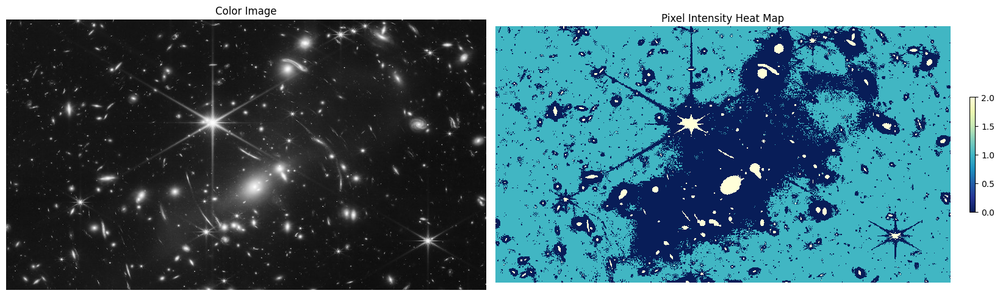

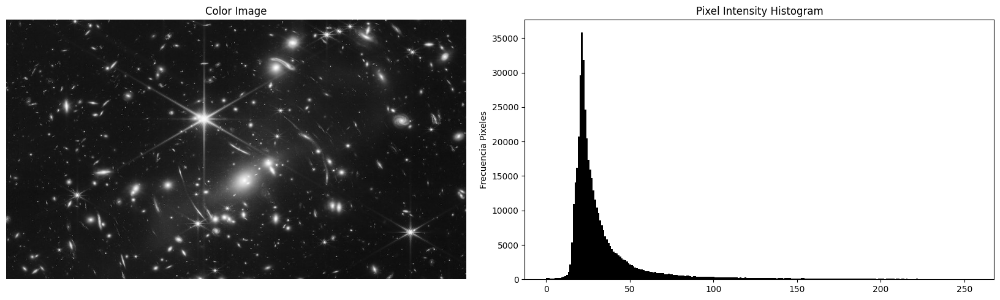

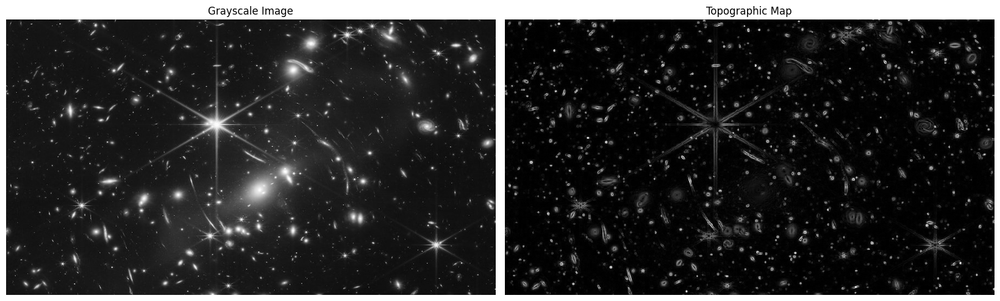

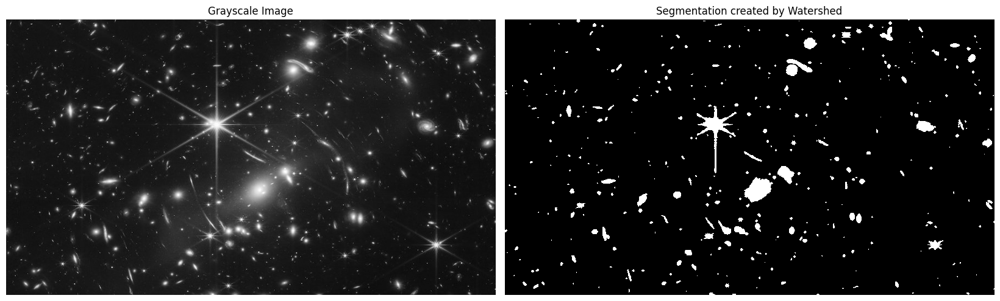

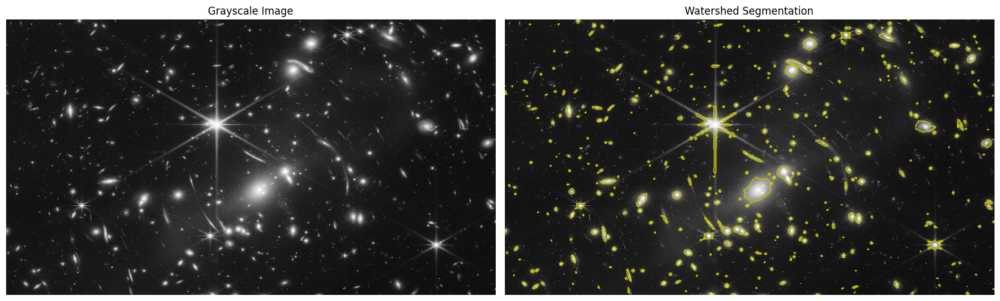

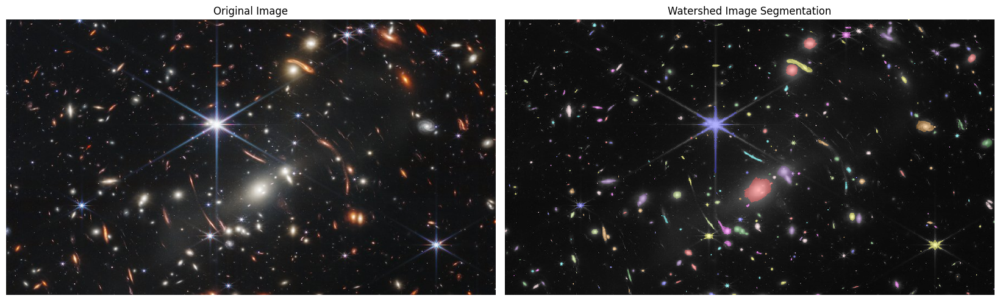

In [18]:
watershed_pipeline('data/stars.jpg')

In [19]:
# Unsplash images


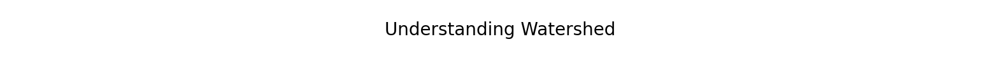

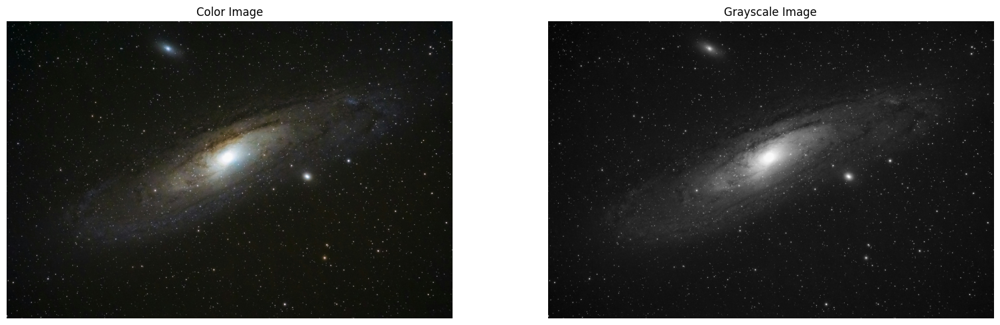

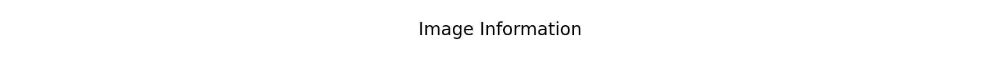

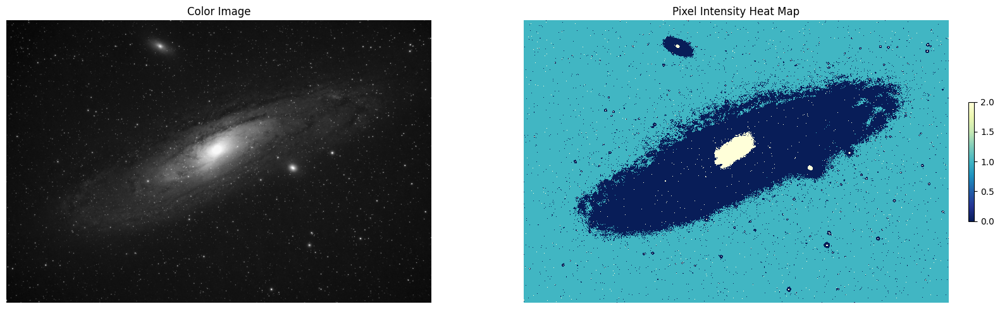

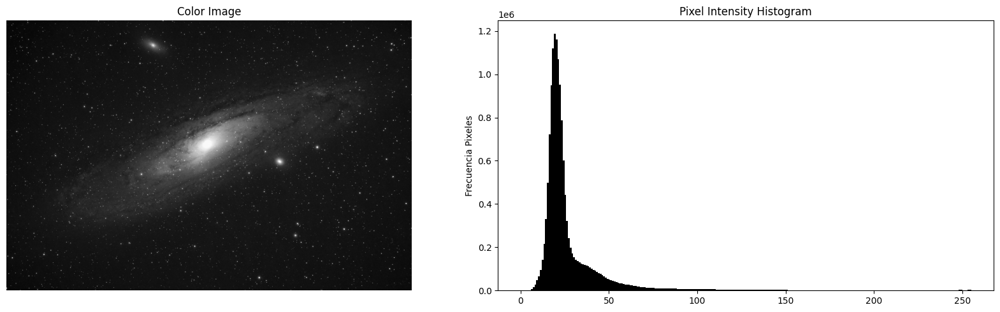

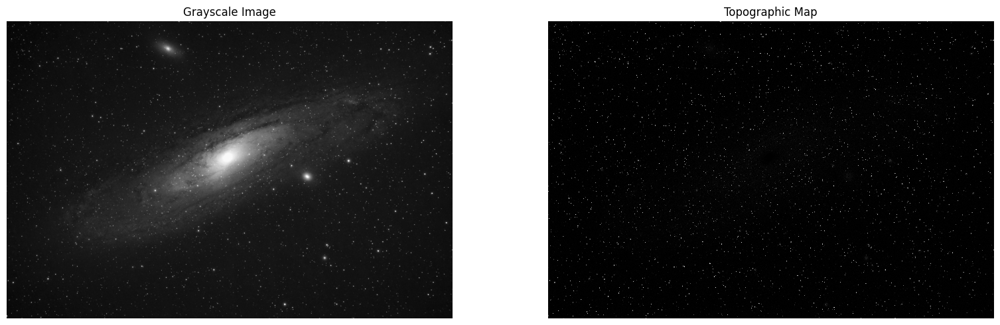

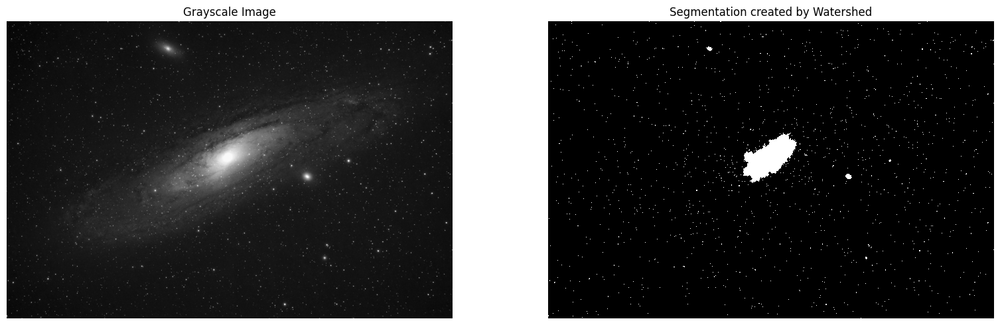

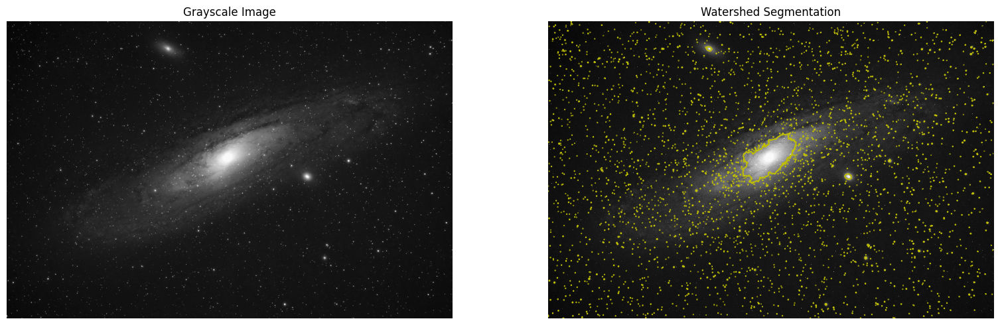

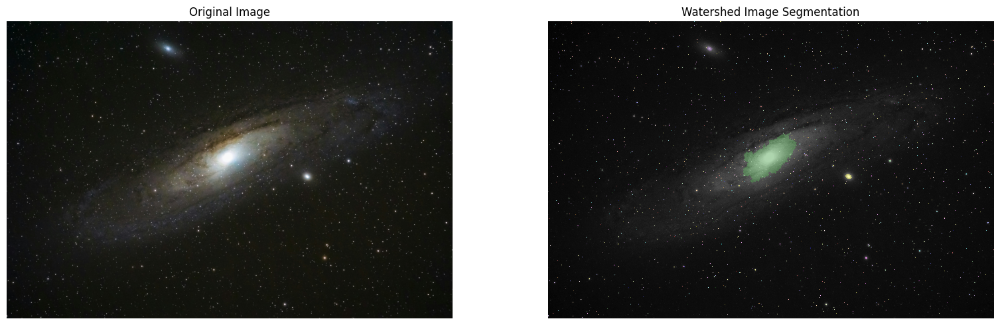

In [20]:
watershed_pipeline('data/bryan-goff-RF4p4rTM-2s-unsplash.jpg')

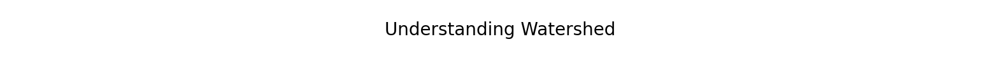

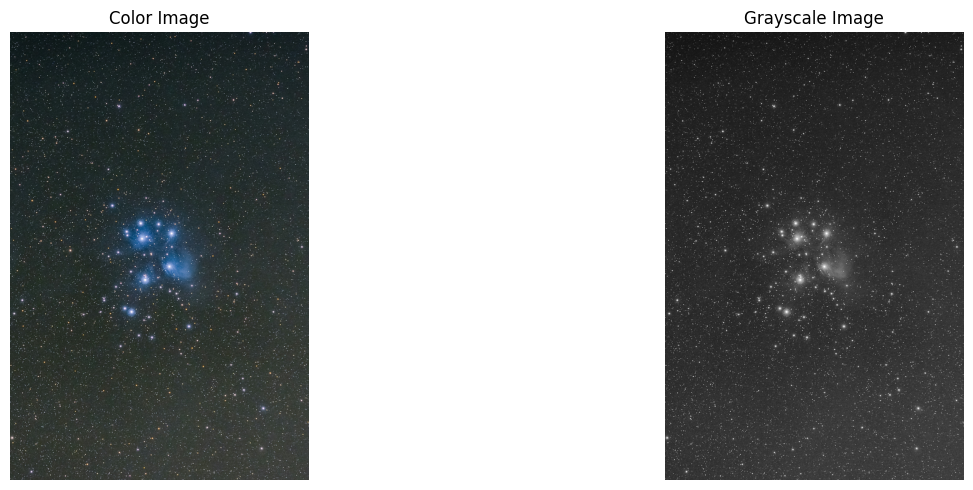

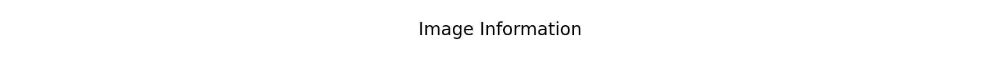

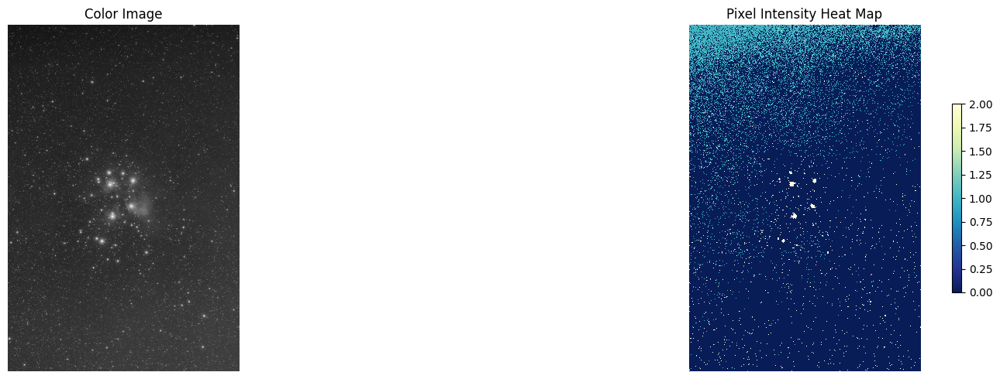

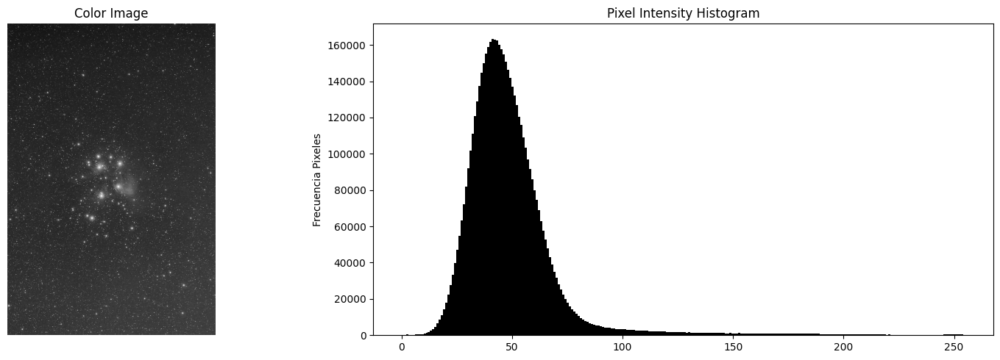

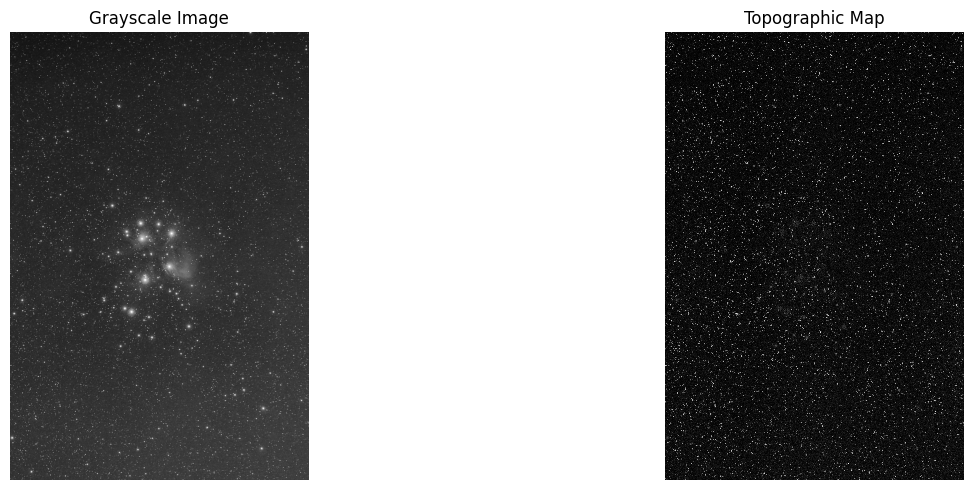

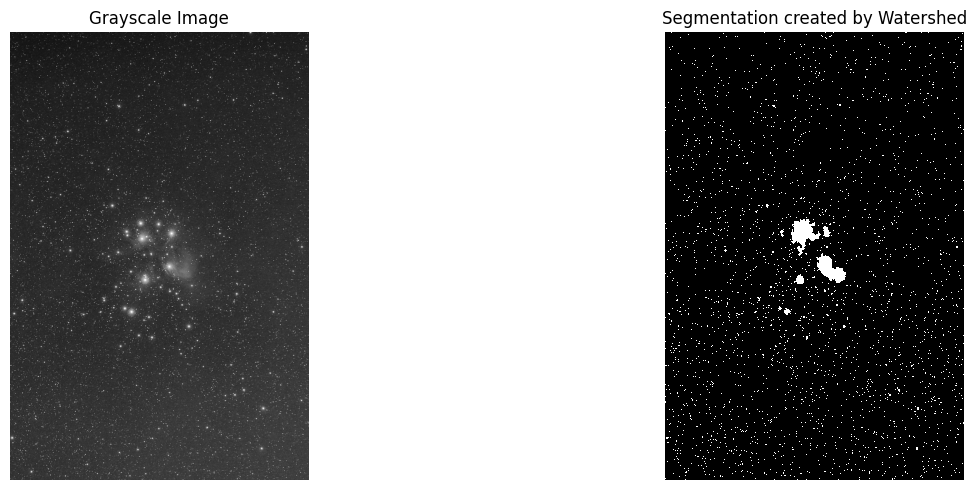

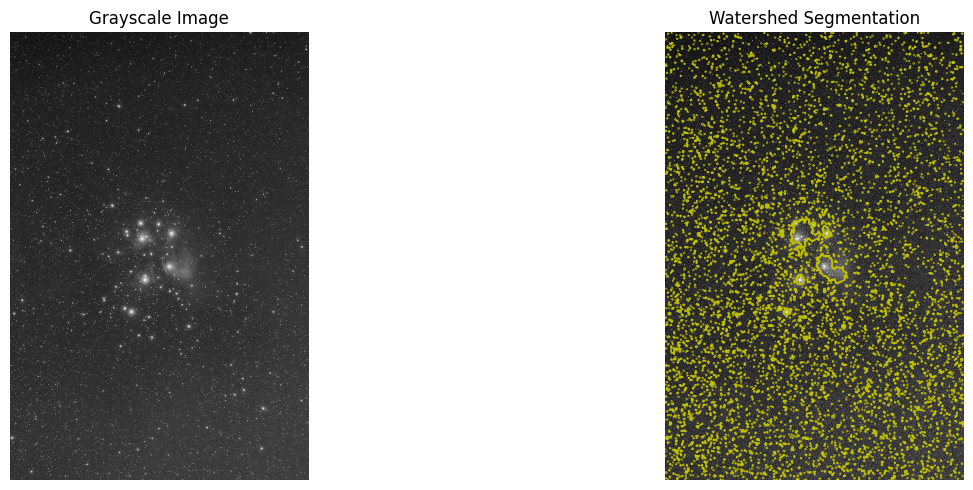

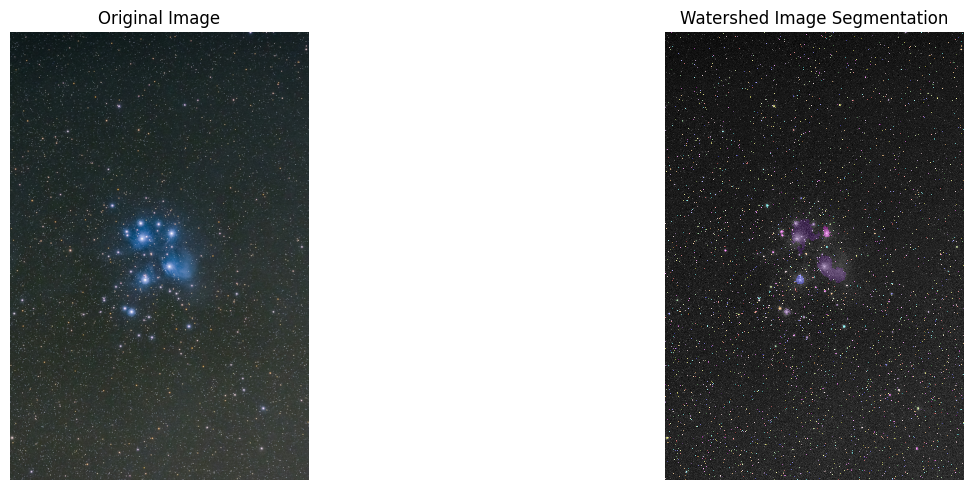

In [21]:
watershed_pipeline('data/bryan-goff-TElAqYMiAME-unsplash.jpg')

In [22]:
# Fin